## Meeting w Refinitiv 28/7

### Agenda today
1. Status since last time
2. Current model output and errors for winter wheat 
3. New features and dataset
4. Climate models and forecasts

### 1. Status

**Since last time:**
* Expanded with a lot of new features (from CMIP6 simulations)
* Merged with harvest area from FAO
* Downloaded and cleaned the cmip datasets for 3 models x 4 scenarios
* Implemented feature transformations (scaling, PCA, correlation-cutoff)
* Implemented advanced architectures (TCN and TFT)
* Rebuild pipeline around Darts and PfT frameworks

**Ongoing:**
* Hyperparameter tuning
* Forecasting scenarios and calculating econ losses
* Testing different hypotheses: 
    * 1 big model vs individual crops
    * PCA vs vars 
    * TCN vs LSTM encoders

**Best model**
* Temporal Fusion Transformer w 3 LSTM layers and 1 attention head
* Currently beats baseline and ARCovariate model with +50%



In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import sys
sys.path.append('..')
from src.h_utils import *
from src.h_geo import *
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [2]:
path = "C:\\Users\\Andreas Langholz\\Yieldcaster\\data\\outputs\\hist_errors\\"
df_loss = pd.read_csv(path + "all_tft_wheat_winter_yield_all_corr0.1_loss.csv", index_col = 0)
df_pred = pd.read_csv(path + "all_tft_wheat_winter_yield_all_corr0.1_pred.csv", index_col = 0)

In [3]:
df_all = get_data(['wheat_spring', 'wheat_winter', 'rice', 'soy', 'maize'], True, False)

### Yield prediction - Winter wheat 2014

Model:
* TFT trained on vars with +10 correlation to winter wheat
* Trained seeing data from 1982 to 2006 and predicting 8 years into future
* Trained for 200 epochs on full dataset

In [4]:
df_results = df_pred[df_pred.year.isin([2012, 2013, 2014])].drop_duplicates()

df_results.rename(columns = {'yield':'real_yield'}, inplace = True)
df_results['yield_error'] = df_results.model_pred_yield - df_results.real_yield
df_results['yield_error_pct'] = df_results.yield_error / df_results.real_yield
df_results = df_results.groupby(['lon', 'lat']).mean().reset_index()

In [5]:
make_map(df_results, 'real_yield', name='yield winter_wheat 2014', legend='tonnes/ha')

In [6]:
make_map(df_results, 'model_pred_yield', name='model yield predictions winter_wheat 2014', legend='tonnes/ha')

In [7]:
make_map(df_results, 'yield_error', name='model yield errors 2014', legend='tonnes/ha')

In [8]:
df_wheat = df_all[df_all.crop == 'wheat_winter']
df_harvest = df_wheat[['lon', 'lat', 'harvest']].drop_duplicates()
df_harvest = df_results.merge(df_harvest, on=['lon', 'lat'])

In [9]:
df_harvest['model_production'] = df_harvest.model_pred_yield * df_harvest.harvest
df_harvest['real_production'] = df_harvest.real_yield * df_harvest.harvest

In [10]:
make_map(df_harvest, 'harvest', name='Harvest area 2010', legend='tonnes/ha')

In [11]:
make_map(df_harvest, 'model_production', name='Harvest area 2010', legend='tonnes/ha')

In [12]:
df_harvest['model_production_cap'] = df_harvest.model_production.apply(lambda x : min(x,250))
make_map(df_harvest, 'model_production_cap', name='Harvest area 2010', legend='tonnes/ha')

In [13]:
make_map(df_harvest, 'real_production', name='Harvest area 2010', legend='tonnes/ha')

In [14]:
df_harvest['real_production_cap'] = df_harvest.real_production.apply(lambda x : min(x,250))
make_map(df_harvest, 'real_production_cap', name='Harvest area 2010', legend='tonnes/ha')

### 3. Data and features 

In [13]:
import matplotlib.pyplot as plt
def plot_col():
    fig = plt.figure(figsize=(15, 10))
    ax  = fig.add_subplot(1, 1, 1)
#    ax.tick_params(axis='x', colors='white')
#    ax.tick_params(axis='y', colors='white')
#    ax.yaxis.label.set_color('white')
#    ax.xaxis.label.set_color('white')
#    ax.title.set_color('white')

def get_var(df, var):
    vars = []
    for i in range(1,13):
        vars.append(var + str(i))
    df_out = df[['yield'] + vars]
    return df_out

year_vars_cmip = ['csdi', 'cwd', 'fd', 'gsl', 'id', 'prcptot',
             'r1mm', 'r10mm', 'r20mm', 'r95p', 'r99p', 'sdii',
             'su', 'tr', 'wsdi']


month_vars_cmip = ['rx1day', 'rx5day', 'tn10p', 'tn90p',
              'tnn', 'tnx', 'tx10p', 'tx90p', 'txn', 'txx']

real_vars = ['cld', 'tmp', 'pre', 'tmn', 'tmx']

<AxesSubplot:>

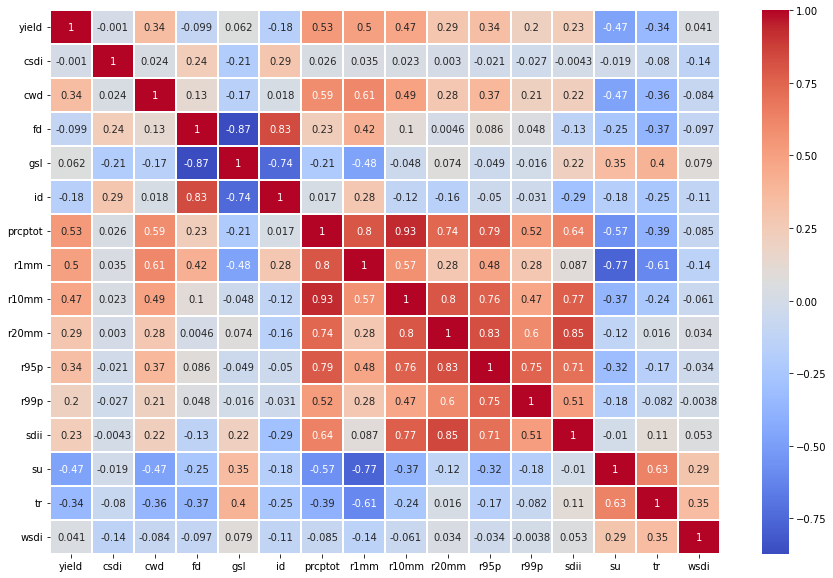

In [16]:
df_cor_yr = df_all[df_all.crop.isin([ 'wheat_winter'])]
df_cor_yr = geo_subset(df_cor_yr, 'europe')
df_cor_yr = df_cor_yr[['yield'] + year_vars_cmip]
plot_col()
sns.heatmap(df_cor_yr.corr(), cmap = 'coolwarm', annot = True, linewidth = 2)


<AxesSubplot:>

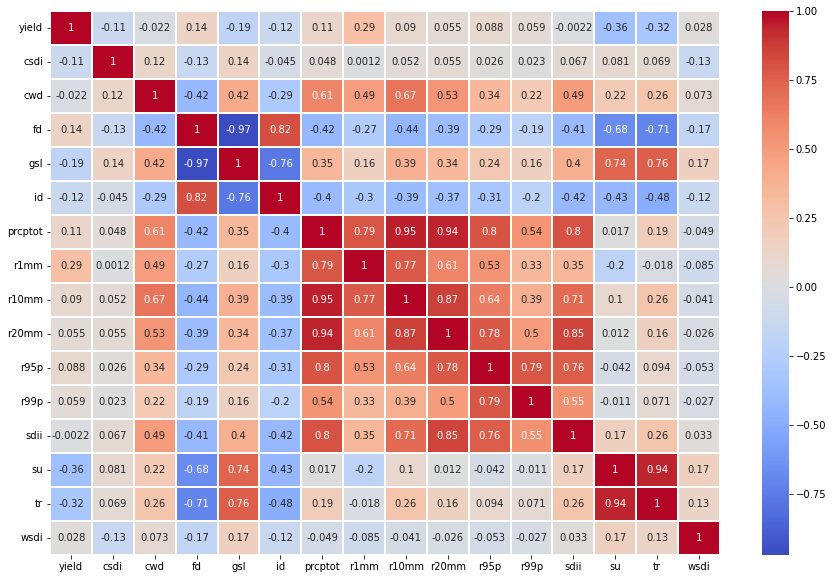

In [17]:
df_cor_yr = df_all[df_all.crop.isin([ 'rice'])]
df_cor_yr = geo_subset(df_cor_yr, 'china')
df_cor_yr = df_cor_yr[['yield'] + year_vars_cmip]
plot_col()
sns.heatmap(df_cor_yr.corr(), cmap = 'coolwarm', annot = True, linewidth = 2)


<AxesSubplot:>

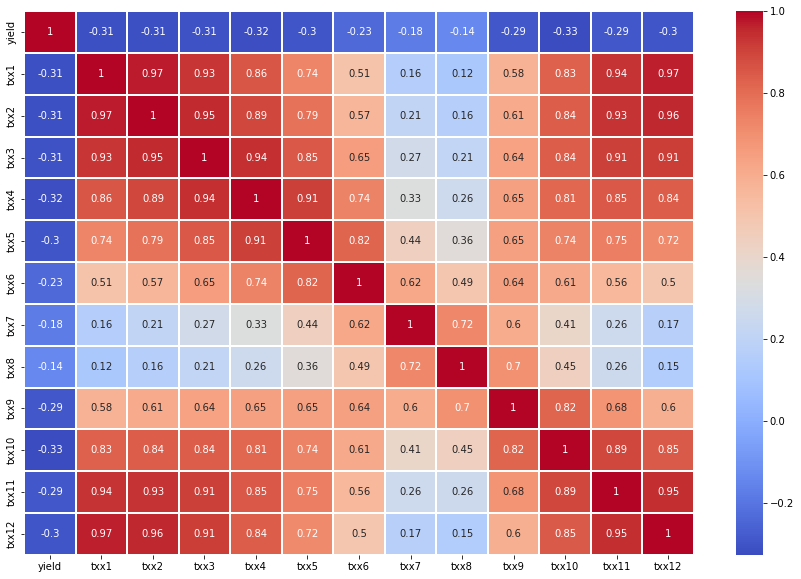

In [18]:
df_cor = df_all[df_all.crop == 'rice']
df_cor = geo_subset(df_cor, 'china')
df_cor = get_var(df_cor, 'txx')
plot_col()
sns.heatmap(df_cor.corr(), cmap = 'coolwarm', annot = True, linewidth = 2)

<AxesSubplot:>

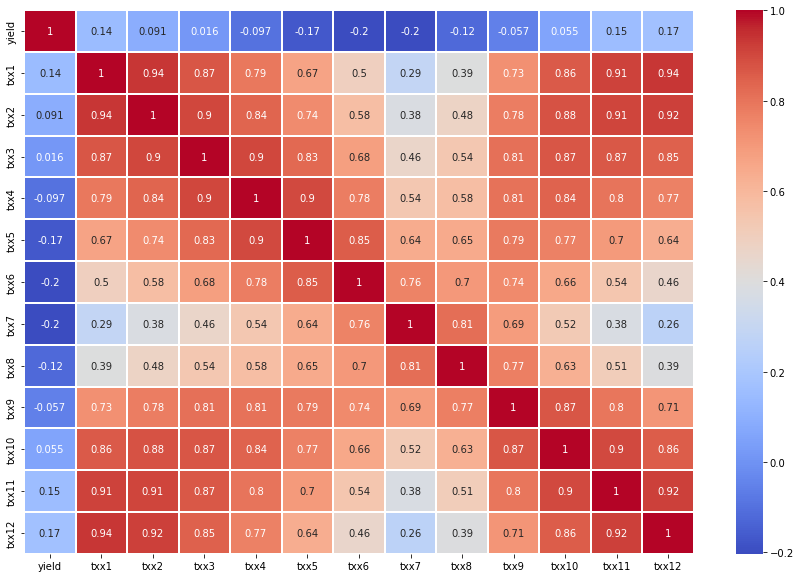

In [19]:
df_cor = df_all[df_all.crop == 'soy']
df_cor = geo_subset(df_cor, 'china')
df_cor = get_var(df_cor, 'txx')
plot_col()
sns.heatmap(df_cor.corr(), cmap = 'coolwarm', annot = True, linewidth = 2)

<AxesSubplot:>

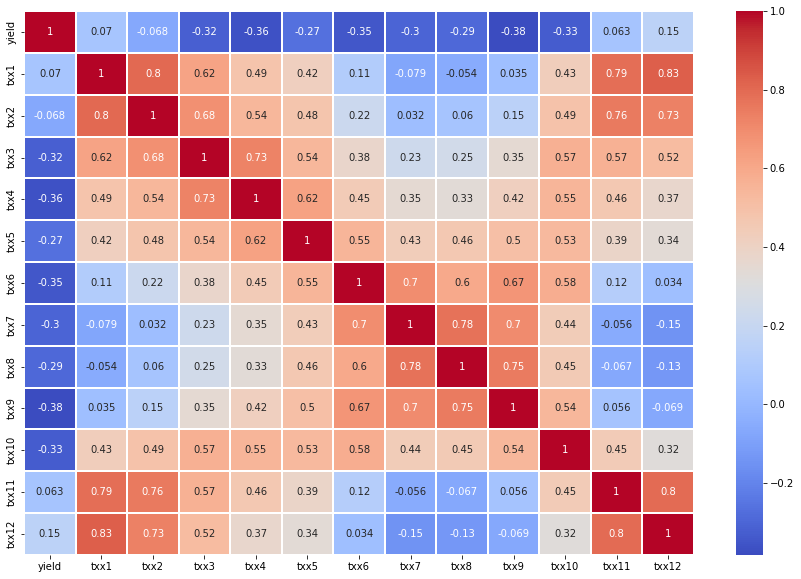

In [20]:
df_cor = df_all[df_all.crop == 'soy']
df_cor = geo_subset(df_cor, 'US')
df_cor = get_var(df_cor, 'txx')
plot_col()
sns.heatmap(df_cor.corr(), cmap = 'coolwarm', annot = True, linewidth = 2)

<AxesSubplot:>

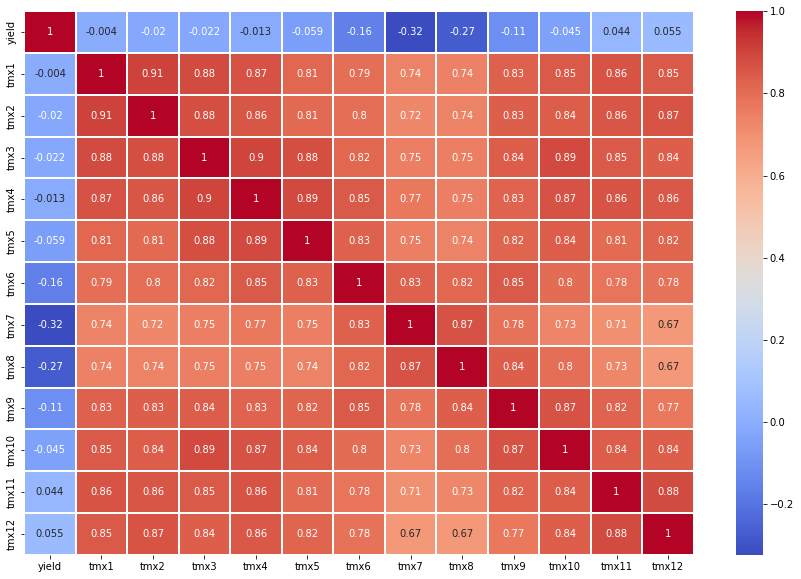

In [21]:
df_cor = df_all[df_all.crop.isin(['soy'])]
df_cor = geo_subset(df_cor, 'US')
df_cor = get_var(df_cor, 'tmx')
plot_col()
sns.heatmap(df_cor.corr(), cmap = 'coolwarm', annot = True, linewidth = 2)


### 4. Climate model for forecasts

#### Current datasets
* Scenarios: SSP126, SSP245, SSP370, SSP585
* Models: MIROC6, CanESM5, ACCESS-ESM1-5
* Time: 2015 - 2100
* Mapped onto yield dataset by shortest euclidian distance



Main rationale: https://www.carbonbrief.org/cmip6-the-next-generation-of-climate-models-explained/ 

### Other questions:
* Any good place for crop prices?


In [21]:

path = "C:\\Users\\Andreas Langholz\\Yieldcaster"
int_path = path + "/data/interrim/"
process_path = path + "/data/processed/"
df_target = pd.read_csv(
    process_path + 'df_train_target_trend.csv', index_col=0)

import pandas as pd
crops = ['rice']

df_target = df_target[df_target.crop.isin(crops)]
yield_mask = pd.read_csv(int_path + 'yieldmask.csv', index_col=0)

df_target = df_target.merge(yield_mask, on=['lon', 'lat'], how='inner')

# Only returns dataset with all years present
df_g = df_target.groupby(['lon', 'lat', 'crop']).size()
df_g = df_g[df_g == df_g.max()]
df_g = df_g.reset_index()
df_target = df_target.merge(df_g, on=['lon', 'lat', 'crop'], how='inner')
df_target.reset_index(drop=True, inplace=True)

df_features = pd.read_csv(
    process_path + 'df_train_features_cruts.csv', index_col=0)

df_all = df_target.merge(df_features, on=['lon', 'lat', 'year'])



<AxesSubplot:>

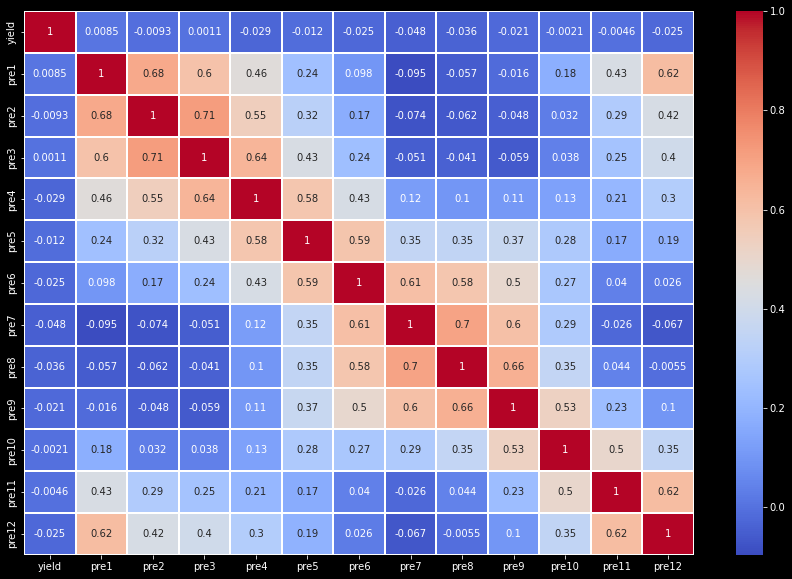

In [23]:
df_cor = geo_subset(df_all, 'china')
df_cor = get_var(df_cor, 'pre')
plot_col()
sns.heatmap(df_cor.corr(), cmap = 'coolwarm', annot = True, linewidth = 2)

In [3]:
import pandas as pd

path = "C:\\Users\\Andreas Langholz\\Yieldcaster"
int_path = path + "/data/interrim/"
process_path = path + "/data/processed/"

df_features = pd.read_csv(
    process_path + 'df_train_features_cruts.csv', index_col=0)



In [32]:
var = 'tmx'
vars = []
for i in range(1, 13):
    vars.append(var + str(i))

df_feat = df_features[['lon', 'lat','year'] + vars] 

In [4]:
from scipy import signal

# Detrending
df_g = df_feat.groupby(['lon', 'lat']).size().reset_index()

df_trend = pd.DataFrame()

df_yield = df_feat.sort_values(['lon', 'lat', 'year'])

df_trend_out = df_feat[['lon', 'lat', 'year']]

for i in range(1,13):
    df_trend = pd.DataFrame()
    var = 'tmx' + str(i)
    for i in range(0, len(df_g)):
        coord = df_g.loc[i]
        df_t = df_yield[(df_yield.lon == coord.lon) & (df_yield.lat == coord.lat)]
        df_t[var] = signal.detrend(df_t[var])
        df_trend = pd.concat([df_trend, df_t], axis=0)
    
    df_trend_out = df_trend_out.merge(df_trend, on=['lon', 'lat', 'year'])




NameError: name 'df_feat' is not defined